In [1]:
#print('Scanpy version:', sc.__version__)

In [2]:
#!pip install --upgrade scan

In [3]:
#print('PyNNDescent version:', pynndescent.__version__)

In [4]:
#import pynndescent

In [5]:
#!pip install --upgrade pynndescent

In [2]:
import scanpy as sc
import pandas as pd
import numpy as np
import os
import scvi
import torch
import warnings
import leidenalg as la
import anndata
from matplotlib import pyplot as plt
from matplotlib.pyplot import rc_context
from scvi.autotune import ModelTuner
from ray import tune
import glob
import re
import csv
import itertools

In [3]:
!mkdir /media/MPEdge16/MM137/sc/py/py_out/pbmc
!mkdir /media/MPEdge16/MM137/sc/py/py_out/adipose

mkdir: cannot create directory ‘/media/MPEdge16/MM137/sc/py/py_out/pbmc’: File exists
mkdir: cannot create directory ‘/media/MPEdge16/MM137/sc/py/py_out/adipose’: File exists


In [4]:
warnings.filterwarnings('ignore')
sc.set_figure_params(dpi=200)
plt.rcParams['figure.figsize'] = [3,3]

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [6]:
os.chdir('/media/MPEdge16/MM137/sc/py/py_out/')

In [11]:
matching_files = glob.glob(os.path.join("/media/MPEdge16/MM137/sc/10x_cloud_dl/", "**/*.h5"), recursive=True)
regex = re.compile(r"MM-[1-8]\b")
pbmc_gex = [x for x in matching_files if regex.search(x)]
def sort_key(file):
    match = re.search(r"MM-(\d+)", file)
    return int(match.group(1)) if match else float('inf') # Uses infinity for files that don't match
pbmc_gex = sorted(pbmc_gex, key=sort_key)
pbmc_gex

['/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-1/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-2/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-3/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-4/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-5/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-6/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-7/filtered_feature_bc_matrix.h5',
 '/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-8/filtered_feature_bc_matrix.h5']

In [12]:
matching_files = glob.glob(os.path.join("/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/", "**/*clusters.tsv"), recursive=True)
regex = re.compile(r"MM-[0-9]+")
fil_dict = zip(matching_files,[regex.search(x).group() for x in matching_files])
pbmc_soc = [x for x, y in fil_dict if y in ['MM-' + str(x) for x in range(1,9)]]
def sort_key(file):
    match = re.search(r"MM-(\d+)", file)
    return int(match.group(1)) if match else float('inf') # Uses infinity for files that don't match
pbmc_soc = sorted(pbmc_soc, key=sort_key)
pbmc_soc

['/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-1_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-2_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-3_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-4_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-5_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-6_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-7_soc/clusters.tsv',
 '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-8_soc/clusters.tsv']

In [13]:
matching_files = glob.glob(os.path.join("/media/MPEdge16/MM137/sc/snp_correlation/", "**/*.txt"), recursive=True)
regex = re.compile(r"(?!MM137)MM[0-9]+")
fil_dict = zip(matching_files,[regex.search(x).group() for x in matching_files])
pbmc_snp = [x for x,y in fil_dict if y in ['MM' + str(x) for x in range(1,9)]]
regex_num = re.compile(r'[0-9]+')
sort_key = [int(x) for x in [regex_num.search(x).group() for x in [x.group() for x in [regex.search(x) for x in pbmc_snp]]]]
pbmc_snp = [pbmc_snp[i] for i in np.argsort(sort_key)]

In [14]:
file_list = [[x,y,z] for x,y,z in zip(pbmc_gex, pbmc_soc, pbmc_snp)]
file_list

[['/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-1/filtered_feature_bc_matrix.h5',
  '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-1_soc/clusters.tsv',
  '/media/MPEdge16/MM137/sc/snp_correlation/MM1/Genotype_ID_key.txt'],
 ['/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-2/filtered_feature_bc_matrix.h5',
  '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-2_soc/clusters.tsv',
  '/media/MPEdge16/MM137/sc/snp_correlation/MM2/Genotype_ID_key.txt'],
 ['/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-3/filtered_feature_bc_matrix.h5',
  '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-3_soc/clusters.tsv',
  '/media/MPEdge16/MM137/sc/snp_correlation/MM3/Genotype_ID_key.txt'],
 ['/media/MPEdge16/MM137/sc/10x_cloud_dl/10872-MM-4/filtered_feature_bc_matrix.h5',
  '/media/MPEdge16/KoetheShare/Mashayekhi_10x/SADIE/souporcell_outs/10872-MM-4_soc/clusters.tsv',
  '/media/MPEdge16/MM137/sc/snp_correlation/MM4/Genotype_ID

In [15]:
def load_gex(list_of_lists):
    gex_file = list_of_lists[0]
    soc_file = list_of_lists[1]
    snp_file = list_of_lists[2]
    match = re.compile(r"MM-[0-9]+")
    lane = match.search(gex_file).group()
    adata = sc.read_10x_h5(gex_file)
    adata.obs['lane'] = lane
    soc = pd.read_csv(soc_file, sep='\t', index_col=0)
    adata = adata[adata.obs.index.isin(soc.index)]
    status_dict = dict(zip(soc.index, soc['status']))
    adata.obs['souporcell_status'] = adata.obs.index.map(status_dict)
    assignment_dict = dict(zip(soc.index, soc['assignment']))
    adata.obs['souporcell_assignment'] = adata.obs.index.map(assignment_dict)
    snp_read = pd.read_csv(snp_file, sep='\t')
    snp_read = snp_read[~np.isnan(snp_read['Correlation'])]
    sadie_match = re.compile(r'Sadie-[0-9]+')
    snp_read['Genotype_ID'] = [sadie_match.search(x).group() for x in snp_read['Genotype_ID']]
    simple_snp_dict = dict(zip(snp_read['Cluster_ID'],snp_read['Genotype_ID']))
    key_permutations = list(itertools.permutations(simple_snp_dict.keys(), 2))
    soc_dict = {}
    for key_perm in key_permutations:
        key_str = '/'.join(key_perm)
        value_str = '/'.join(str(simple_snp_dict[k]) for k in key_perm)
        soc_dict[key_str] = value_str
    soc_dict_full = simple_snp_dict.copy()
    soc_dict_full.update(soc_dict)
    adata.obs['study_id'] = adata.obs['souporcell_assignment'].map(soc_dict_full)
    match_2 = re.compile(r'[0-9]+')
    lane_num = match_2.search(lane).group()
    match_3 = re.compile(r'[A-Z]+')
    bc_oligo = [match_3.search(x).group() for x in adata.obs_names]
    adj_bc = [x + '-' + y for x,y in zip(bc_oligo, lane_num * len(bc_oligo))]
    adata.obs['barcode_2'] = adj_bc
    adata = adata[adata.obs['souporcell_status']!='unassigned']
    adata.obs_names = adata.obs['barcode_2']
    adata.obs_names_make_unique()
    adata.obs.index = adata.obs_names
    adata.var_names_make_unique()
    return adata

In [16]:
adatas = [load_gex(x) for x in file_list]

In [17]:
lane_layout = pd.read_csv("/media/MPEdge16/MM137/sc/MM148_key.csv", index_col=0)
lane_layout = lane_layout[lane_layout['Tissue type']=='PBMCs']
pbmc_lanes = lane_layout['Multiplex ID'].unique()
for i in pbmc_lanes:
    subset_layout = lane_layout[lane_layout['Multiplex ID']==i]
    subset_layout_dict = dict(zip(subset_layout['Sample ID'],subset_layout['Study day']))
    key_permutations = list(itertools.permutations(subset_layout_dict.keys(), 2))
    pid_lane_dict = {}
    for key_perm in key_permutations:
        key_str = '/'.join(key_perm)
        value_str = '/'.join(str(subset_layout_dict[k]) for k in key_perm)
        pid_lane_dict[key_str] = value_str
    pid_lane_dict_tmp = subset_layout_dict.copy()
    pid_lane_dict_tmp.update(pid_lane_dict)
    tmp_list = [(x,y) for x,y in pid_lane_dict_tmp.items()]
    tmp_df = pd.DataFrame(tmp_list, columns=['study_id', 'sd'])
    tmp_df['lane'] = str(i)
    if i==pbmc_lanes[0]:
        pid_lane_df = tmp_df.copy()
    else:
        pid_lane_df = pd.concat([pid_lane_df,tmp_df])
pid_lane_df['pid_lane'] = [x+'_'+y for x,y in zip(pid_lane_df['study_id'], pid_lane_df['lane'])]

In [18]:
def add_sd(ad, sd_map_dict = pid_lane_df):
    if len(ad.obs['lane'].unique())==1:
        subset_map = pid_lane_df[pid_lane_df['lane']==re.sub('MM-','',ad.obs['lane'][0])]
        ad.obs['map_sd'] = [x+'_'+y for x,y in zip([re.sub('-','',x).upper() for x in ad.obs['study_id']], [re.sub('MM-','',x) for x in ad.obs['lane']])]
        ad.obs['study_day'] = ad.obs['map_sd'].map(dict(zip(subset_map['pid_lane'],subset_map['sd'])))
        return ad
    else:
        return 'failed to execute'

In [19]:
adatas = [add_sd(x) for x in adatas]

In [20]:
adata = sc.concat(adatas)

In [21]:
matching_files = glob.glob(os.path.join("/media/MPEdge16/MM137/sc/py/py_out/", "**/solo_scores_MM**.csv"), recursive=True)
regex = re.compile(r"(?!MM137)MM[0-9]+")
fil_dict = zip(matching_files,[regex.search(x).group() for x in matching_files])
pbmc_solo = [x for x,y in fil_dict if y in ['MM' + str(x) for x in range(1,9)]]
regex_num = re.compile(r'[0-9]+')
sort_key = [int(x) for x in [regex_num.search(x).group() for x in [x.group() for x in [regex.search(x) for x in pbmc_solo]]]]
pbmc_solo = [pbmc_solo[i] for i in np.argsort(sort_key)]
pbmc_solo

['/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM1.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM2.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM3.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM4.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM5.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM6.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM7.csv',
 '/media/MPEdge16/MM137/sc/py/py_out/solo_scores_MM8.csv']

In [22]:
for i in pbmc_solo:
    tmp_scores = pd.read_csv(i, index_col=0)
    match = re.compile(r"(?!MM137)MM[0-9]+")
    match_lane = match.search(i).group()
    match_2 = re.compile(r'[0-9]')
    match_num = match_2.search(match_lane).group()
    match_oligo = re.compile(r'[A-Z]+')
    tmp_scores.index = [x+'-'+y for x,y in zip([match_oligo.search(x).group() for x in tmp_scores.index], str(match_num)*tmp_scores.shape[0])]
    if i==pbmc_solo[0]:
        solo_scores = tmp_scores.copy()
    else:
        solo_scores = pd.concat([solo_scores,tmp_scores])
solo_scores = dict(zip(solo_scores.index, solo_scores.prediction))

In [23]:
adata.obs['solo_prediction'] = adata.obs.index.map(solo_scores)
adata.obs['solo_prediction'] = adata.obs['solo_prediction'].fillna('souporcell_doublet')

In [24]:
adata.obs

,lane,souporcell_status,souporcell_assignment,study_id,barcode_2,map_sd,study_day,solo_prediction
barcode_2,,,,,,,,
AAACCTGAGAAGATTC-1,MM-1,singlet,1,Sadie-018,AAACCTGAGAAGATTC-1,SADIE018_1,SD1,doublet
AAACCTGAGACCTAGG-1,MM-1,singlet,1,Sadie-018,AAACCTGAGACCTAGG-1,SADIE018_1,SD1,singlet
AAACCTGAGAGACGAA-1,MM-1,singlet,1,Sadie-018,AAACCTGAGAGACGAA-1,SADIE018_1,SD1,doublet
AAACCTGAGAGAGCTC-1,MM-1,doublet,1/2,Sadie-018/Sadie-016,AAACCTGAGAGAGCTC-1,SADIE018/SADIE016_1,SD1/SD1,souporcell_doublet
AAACCTGAGAGCCCAA-1,MM-1,singlet,0,Sadie-011,AAACCTGAGAGCCCAA-1,SADIE011_1,SD1,singlet
...,...,...,...,...,...,...,...,...
TTTGTCATCTACCAGA-8,MM-8,doublet,2/1,Sadie-038/Sadie-016,TTTGTCATCTACCAGA-8,SADIE038/SADIE016_8,SD3/SD2,souporcell_doublet
TTTGTCATCTATCCTA-8,MM-8,singlet,0,Sadie-036,TTTGTCATCTATCCTA-8,SADIE036_8,SD3,doublet
TTTGTCATCTGATACG-8,MM-8,singlet,2,Sadie-038,TTTGTCATCTGATACG-8,SADIE038_8,SD3,singlet


In [25]:
sc.pp.filter_cells(adata, min_genes = 200)
sc.pp.filter_genes(adata, min_cells = 10)
adata.var['MT'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=["MT"], inplace=True, percent_top=[20], log1p=True)
adata = adata[adata.obs.pct_counts_MT <= 10]

In [27]:
adata.layers['counts'] = adata.X.copy()

In [28]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [29]:
sc.pp.highly_variable_genes(adata, n_top_genes=5000, subset = False, layer = 'counts', 
                            flavor = "seurat_v3", batch_key="lane")

In [30]:
adata_var = adata.var
csv_data = pd.read_csv('/media/MPEdge16/MM137/sc/EXCLUDE_XY_TCR_IG.csv', header = None)

positions = np.where(adata.var_names.isin(csv_data[0]))[0]
adata.var.iloc[positions, adata.var.columns.get_loc('highly_variable')] = False
adata.var.loc[adata.var.index=="TRAV1-2", "highly_variable"] = True # force TRAV1-2 to be hvg; MAIT marker
adata.var['highly_variable'].value_counts()

highly_variable
False    21063
True      4510
Name: count, dtype: int64

In [31]:
model_cls = scvi.model.SCVI
model_cls.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                        categorical_covariate_keys=['study_id'], 
                        continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
tuner = ModelTuner(model_cls)

In [32]:
tuner.info()

ModelTuner registry for SCVI

                  Tunable hyperparameters                  
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━┓
┃      Hyperparameter      ┃ Default value ┃    Source    ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━┩
│         n_hidden         │      128      │     VAE      │
│         n_latent         │      10       │     VAE      │
│         n_layers         │       1       │     VAE      │
│       dropout_rate       │      0.1      │     VAE      │
│        dispersion        │     gene      │     VAE      │
│     log_variational      │     True      │     VAE      │
│     gene_likelihood      │     zinb      │     VAE      │
│   latent_distribution    │    normal     │     VAE      │
│    encode_covariates     │     False     │     VAE      │
│ deeply_inject_covariates │     True      │     VAE      │
│      use_batch_norm      │     both      │     VAE      │
│      use_layer_norm      │     none      │     VAE      │
│  use_observed_lib_size   │     True      │     VAE      │
│      var_activation      │     None      │     VAE      │
│        optimizer         │     Adam      │ TrainingPlan │
│            lr            │     0.001     │ TrainingPlan │
│       weight_decay       │     1e-06     │ TrainingPlan │
│           eps            │     0.01      │ TrainingPlan │
│    n_steps_kl_warmup     │     None      │ TrainingPlan │
│    n_epochs_kl_warmup    │      400      │ TrainingPlan │
│   reduce_lr_on_plateau   │     False     │ TrainingPlan │
│        lr_factor         │      0.6      │ TrainingPlan │
│       lr_patience        │      30       │ TrainingPlan │
│       lr_threshold       │      0.0      │ TrainingPlan │
│          lr_min          │       0       │ TrainingPlan │
│      max_kl_weight       │      1.0      │ TrainingPlan │
│      min_kl_weight       │      0.0      │ TrainingPlan │
│        batch_size        │      128      │     SCVI     │
└──────────────────────────┴───────────────┴──────────────┘

       Available metrics        
┏━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃     Metric      ┃    Mode    ┃
┡━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ validation_loss │    min     │
└─────────────────┴────────────┘

                         Default search space                         
┏━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Hyperparameter ┃ Sample function ┃  Arguments  ┃ Keyword arguments ┃
┡━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│    n_hidden    │     choice      │ [[64, 128]] │        {}         │
└────────────────┴─────────────────┴─────────────┴───────────────────┘

In [33]:
search_space = {
    "n_hidden": tune.choice([92, 128, 192, 256]),
    "n_latent": tune.choice([10, 20, 30, 40, 50, 60]),
    "n_layers": tune.choice([1, 2, 3]),
    "lr": tune.loguniform(1e-4, 1e-2),
    "gene_likelihood": tune.choice(["nb", "zinb"])}

In [34]:
results = tuner.fit(adata, metric="validation_loss",
                    resources = {'gpu': 1}, 
                    search_space = search_space,
                    num_samples = 100,
                    max_epochs = 20)

2024-10-22 19:08:21,394	INFO worker.py:1749 -- Started a local Ray instance.
2024-10-22 19:08:24,507	INFO tune.py:253 -- Initializing Ray automatically. For cluster usage or custom Ray initialization, call `ray.init(...)` before `Tuner(...)`.
2024-10-22 19:08:24,511	INFO tune.py:614 -- [output] This uses the legacy output and progress reporter, as Jupyter notebooks are not supported by the new engine, yet. For more information, please see https://github.com/ray-project/ray/issues/36949
(_trainable pid=1328260) /media/MPEdge16/miniconda_ns/lib/python3.9/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.
(_trainable pid=1328260) 
(_trainable pid=1328260) For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.
(_trainable pid=1328260) 
(_trainable pid=1328260) For creation, use `anndata.experimental.sparse_dataset(X)` ins

In [35]:
best_vl = 10000
best_i = 0
for i, res in enumerate(results.results):
    vl = res.metrics['validation_loss']

    if vl < best_vl:
        best_vl = vl
        best_i = i

In [41]:
tuner_res = str(results.results[best_i])
tuner_res

"Result(\n  metrics={'validation_loss': 4127.42822265625},\n  path='/media/MPEdge16/MM137/sc/py/scvi_log/autotune/2024-10-22_19-08-09_scvi/_trainable_c566e0b0_69_gene_likelihood=zinb,lr=0.0016,n_hidden=128,n_latent=60,n_layers=2_2024-10-23_01-45-35',\n  filesystem='local',\n  checkpoint=None\n)"

![parameter_tuning](/media/MPEdge16/MM137/sc/py/misc/optimal_integration_parameters_round_1.png)

In [49]:
match_gene_likelihood_1 = re.compile(r'gene_likelihood=(nb|zinb)')
gl_1 = match_gene_likelihood_1.search(tuner_res).group()
match_gene_likelihood_2 = re.compile(r'(nb|zinb)')
gene_likelihood_param = match_gene_likelihood_2.search(gl_1).group()

In [50]:
nlayer_1 = re.compile(r'n_layers=[0-9]+')
nl_1 = nlayer_1.search(tuner_res).group()
nlayer_2 = re.compile(r'[0-9]+')
n_layers_param = int(nlayer_2.search(nl_1).group())

In [55]:
nlatent_1 = re.compile(r'n_latent=[0-9]+')
nlat_1 = nlatent_1.search(tuner_res).group()
nlatent_2 = re.compile(r'[0-9]+')
n_latent_param = int(nlatent_2.search(nlat_1).group())

In [58]:
nhidden_1 = re.compile(r'n_hidden=[0-9]+')
nh_1 = nhidden_1.search(tuner_res).group()
nhidden_2 = re.compile(r'[0-9]+')
n_hidden_param = int(nhidden_2.search(nh_1).group())

In [61]:
learn_1 = re.compile(r'lr=[0-9\\.]+')
lr_1 = learn_1.search(tuner_res).group()
learn_2 = re.compile(r'[0-9\\.]+')
lr_param = float(learn_2.search(lr_1).group())

In [64]:
{'n_hidden': n_hidden_param, 
'n_latent': n_latent_param, 
'n_layers': n_layers_param, 
'gene_likelihood': gene_likelihood_param, 
'lr': lr_param}

{'n_hidden': 128,
 'n_latent': 60,
 'n_layers': 2,
 'gene_likelihood': 'zinb',
 'lr': 0.0016}

In [65]:
scvi.model.SCVI.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                              categorical_covariate_keys=['study_id'], 
                              continuous_covariate_keys=['pct_counts_MT', 'total_counts'])

In [66]:
model = scvi.model.SCVI(adata, n_hidden = n_hidden_param, n_latent = n_latent_param, n_layers = n_layers_param, gene_likelihood = gene_likelihood_param)
kwargs = {'lr': lr_param}

In [67]:
model.train(max_epochs = 200, early_stopping = True, plan_kwargs = kwargs)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA RTX 4000 Ada Generation') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 200/200: 100%|████████████████████████████████████████████████████████████████████████████| 200/200 [3:11:55<00:00, 58.44s/it, v_num=1, train_loss_step=3.99e+3, train_loss_epoch=4.14e+3]

`Trainer.fit` stopped: `max_epochs=200` reached.


Epoch 200/200: 100%|████████████████████████████████████████████████████████████████████████████| 200/200 [3:11:55<00:00, 57.58s/it, v_num=1, train_loss_step=3.99e+3, train_loss_epoch=4.14e+3]


In [68]:
y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()

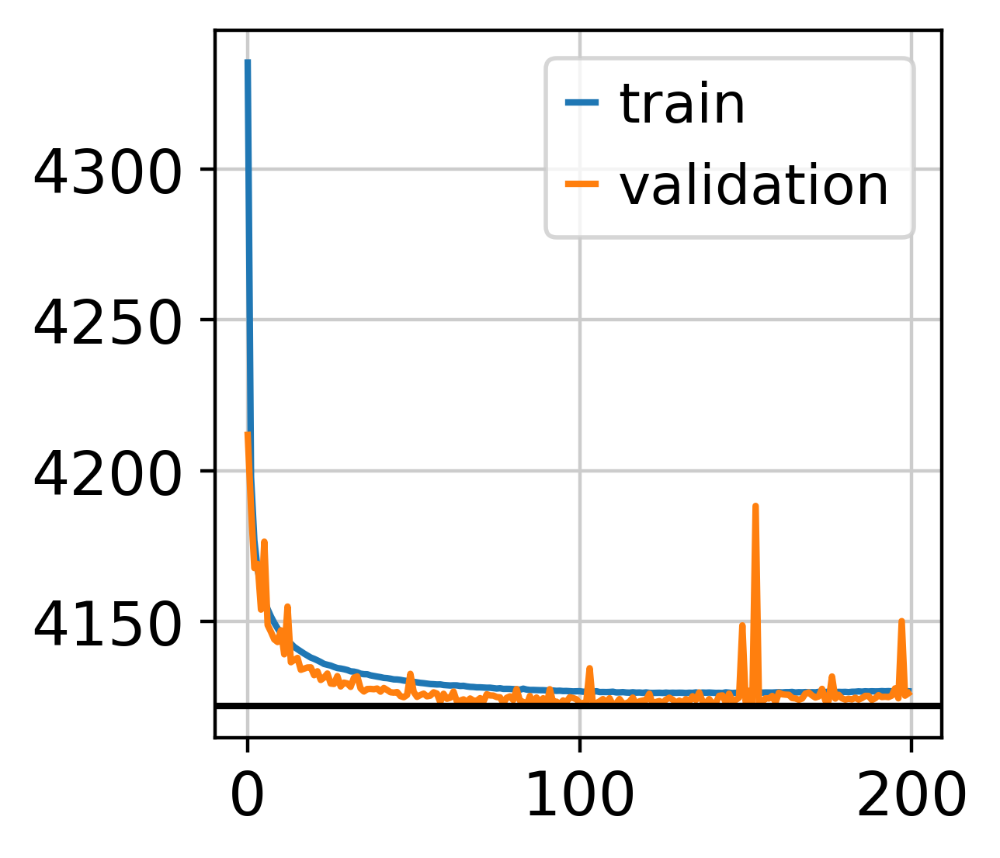

In [69]:
plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation')

plt.axhline(y, c = 'k')

plt.legend()
plt.show()

In [3]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_dbl.h5ad')
#model.save('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_scvi_integration_model_dbl')
model = scvi.model.SCVI.load('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_scvi_integration_model_dbl/', adata)
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_dbl.h5ad')

INFO     File /media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_scvi_integration_model_dbl/model.pt already downloaded  


/media/MPEdge16/miniconda_ns/lib/python3.9/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

  return _abc_instancecheck(cls, instance)


In [4]:
adata.obsm['X_scVI'] = model.get_latent_representation()
scvi_norm_count = model.get_normalized_expression(library_size = 1e4)
adata.layers['scvi_normalized'] = scvi_norm_count

In [5]:
sc.pp.neighbors(adata, use_rep = 'X_scVI', random_state = 123)

In [6]:
sc.tl.leiden(adata, resolution = 3, key_added = 'overcluster')

In [7]:
sc.tl.umap(adata)

In [29]:
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_int_dbl.h5ad')
#adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_int_dbl.h5ad')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


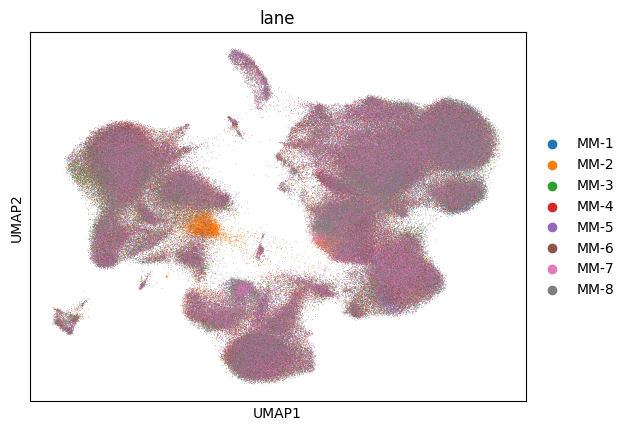

In [9]:
sc.pl.umap(adata, color = 'lane', size = 1, legend_fontsize = 'medium')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


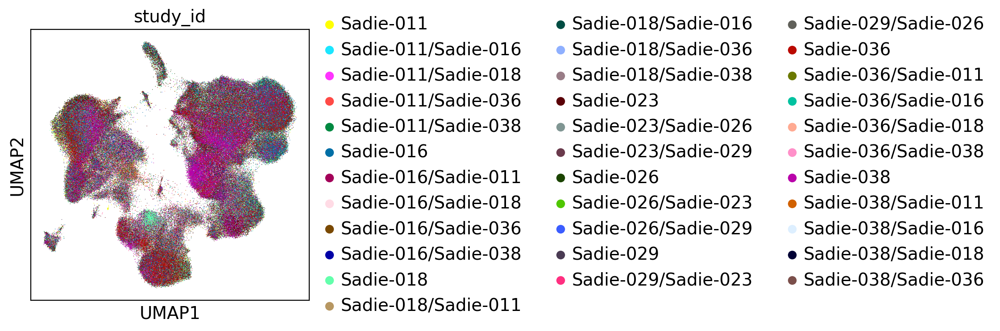

In [14]:
sc.pl.umap(adata, color = 'study_id', size = 1, legend_fontsize = 'medium')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


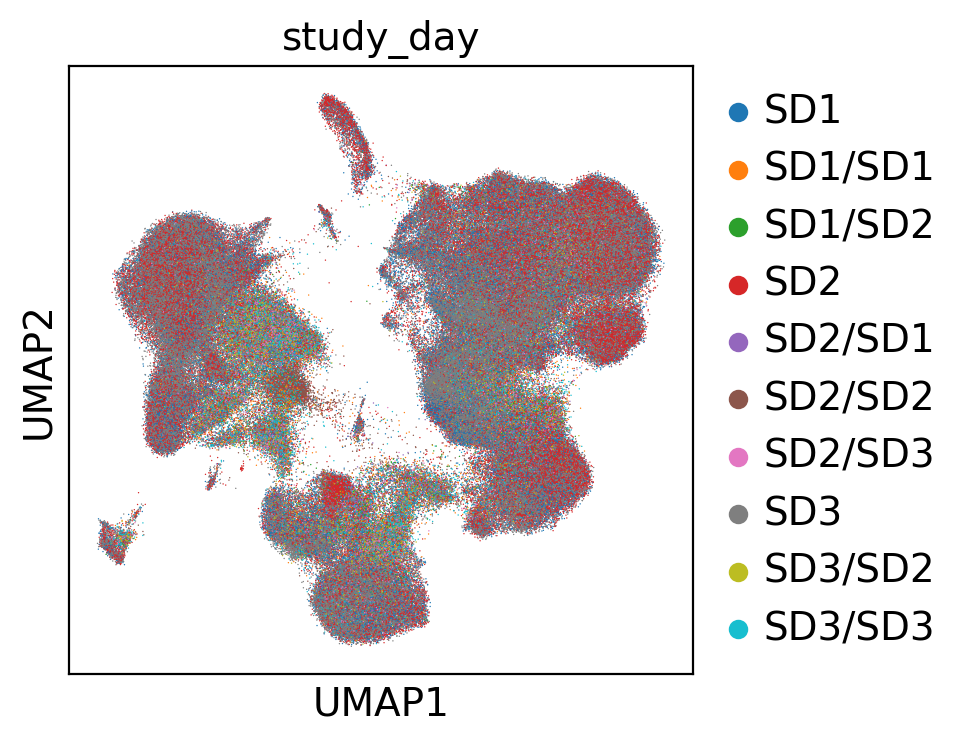

In [15]:
sc.pl.umap(adata, color = 'study_day', size = 1, legend_fontsize = 'medium')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


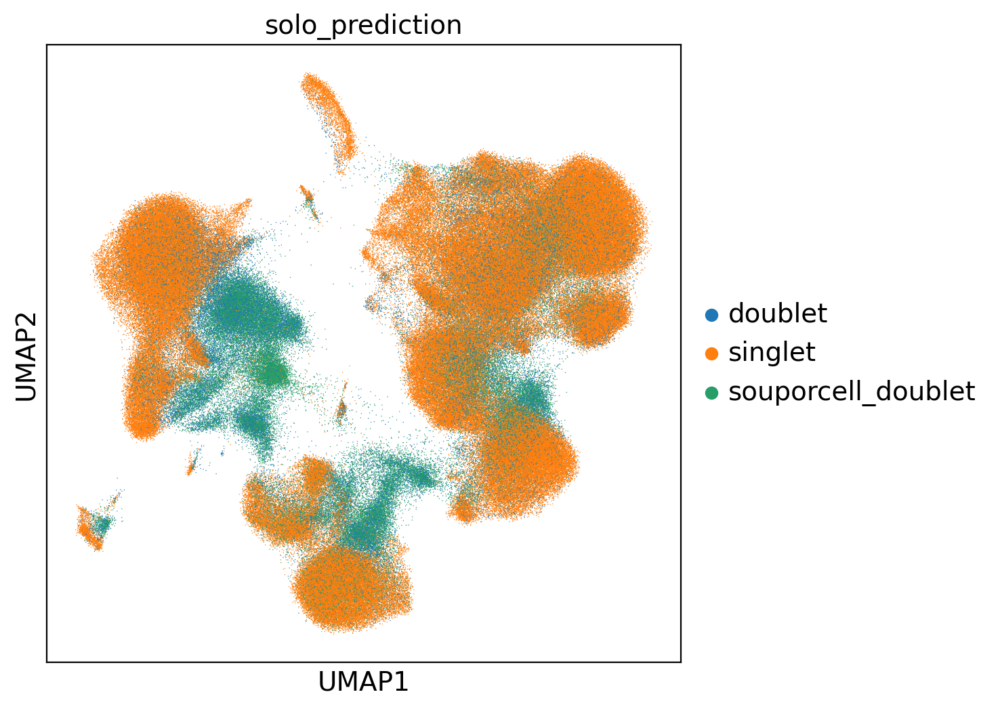

In [104]:
plt.rcParams['figure.figsize'] = [6, 6] # width, height
sc.pl.umap(adata, color = 'solo_prediction', size = 1, legend_fontsize = 'medium')

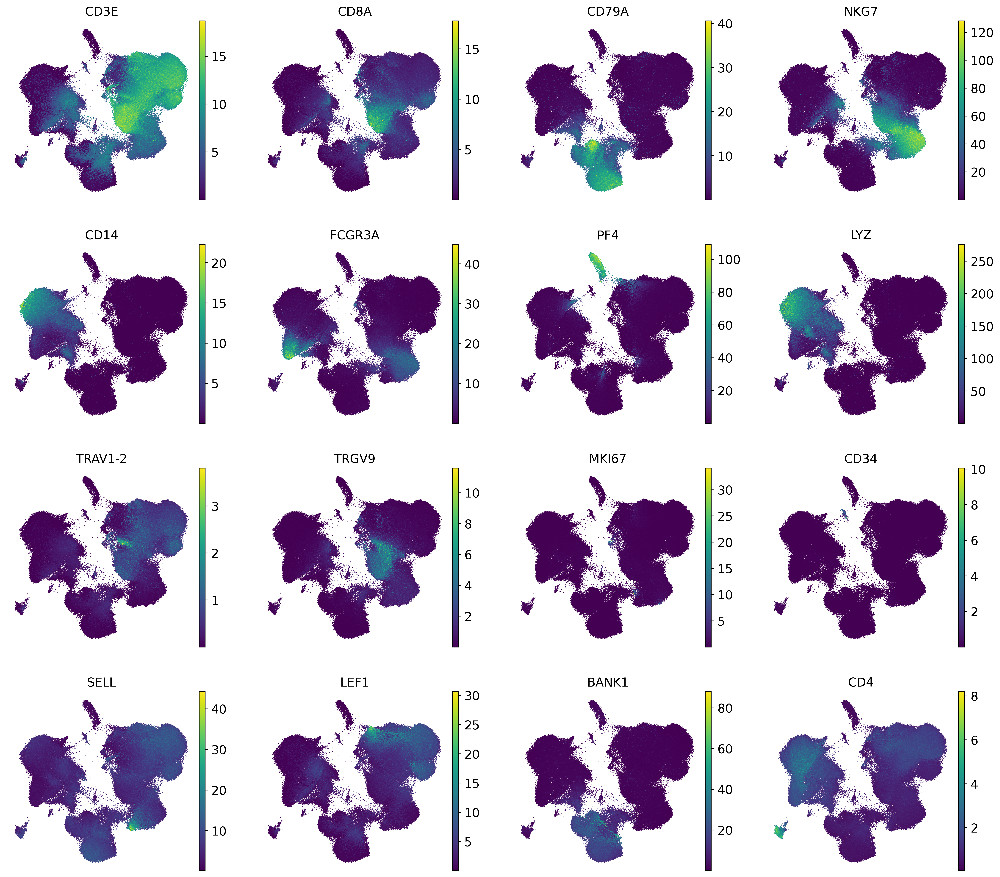

In [11]:
sc.set_figure_params(dpi=200)

sc.pl.umap(adata, color = ['CD3E','CD8A','CD79A','NKG7','CD14','FCGR3A','PF4','LYZ','TRAV1-2','TRGV9','MKI67','CD34','SELL','LEF1','BANK1','CD4'], size = 2, frameon = False, layer = 'scvi_normalized')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


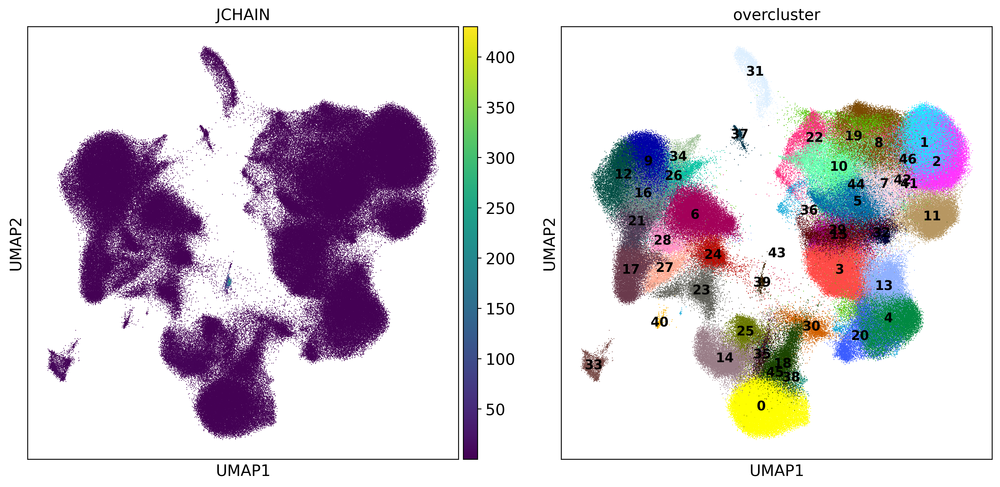

In [12]:
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color = ['JCHAIN','overcluster'], legend_loc = 'on data', size = 2, layer = 'scvi_normalized', legend_fontsize = 'small')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


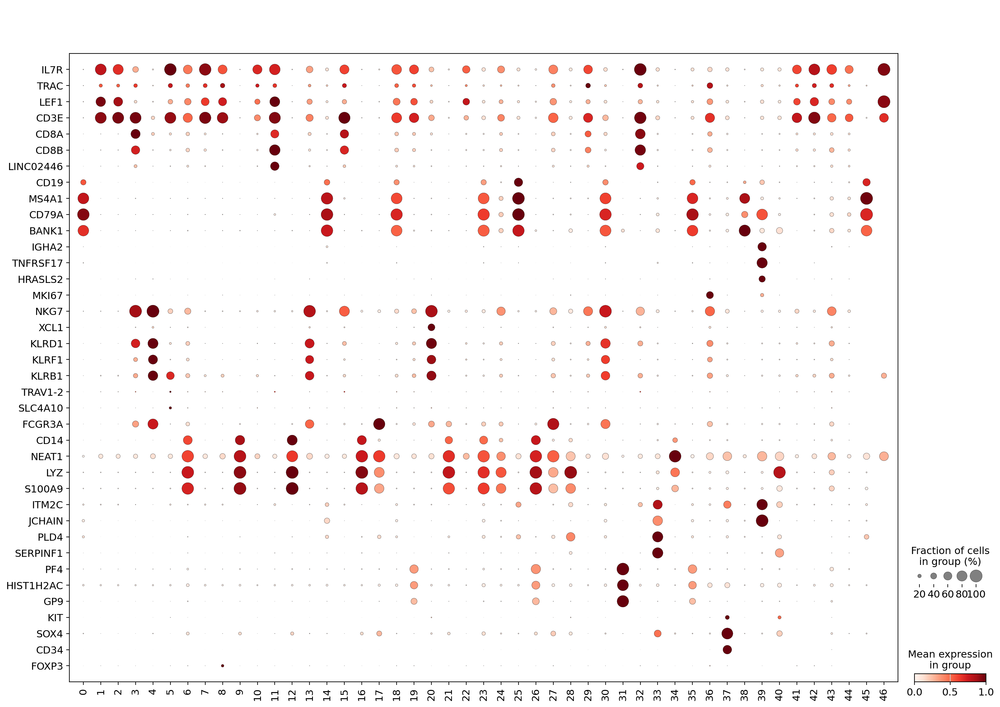

In [13]:
sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata, ['IL7R', 'TRAC', 'LEF1', 'CD3E', 'CD8A', 'CD8B', 'LINC02446', 'CD19', 'MS4A1', 'CD79A', 'BANK1', 'IGHA2', 'TNFRSF17', 'HRASLS2', 'MKI67', 'NKG7', 'XCL1', 'KLRD1', 'KLRF1', 'KLRB1', 'TRAV1-2', 'SLC4A10', 'FCGR3A', 'CD14', 'NEAT1', 'LYZ', 'S100A9', 'ITM2C','JCHAIN','PLD4','SERPINF1', 'PF4', 'HIST1H2AC', 'GP9', 'KIT', 'SOX4','CD34','FOXP3'], groupby = 'overcluster', swap_axes = True,
              use_raw = True, standard_scale = 'var', dendrogram = False)

In [16]:
adata_singlet = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_final.h5ad')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


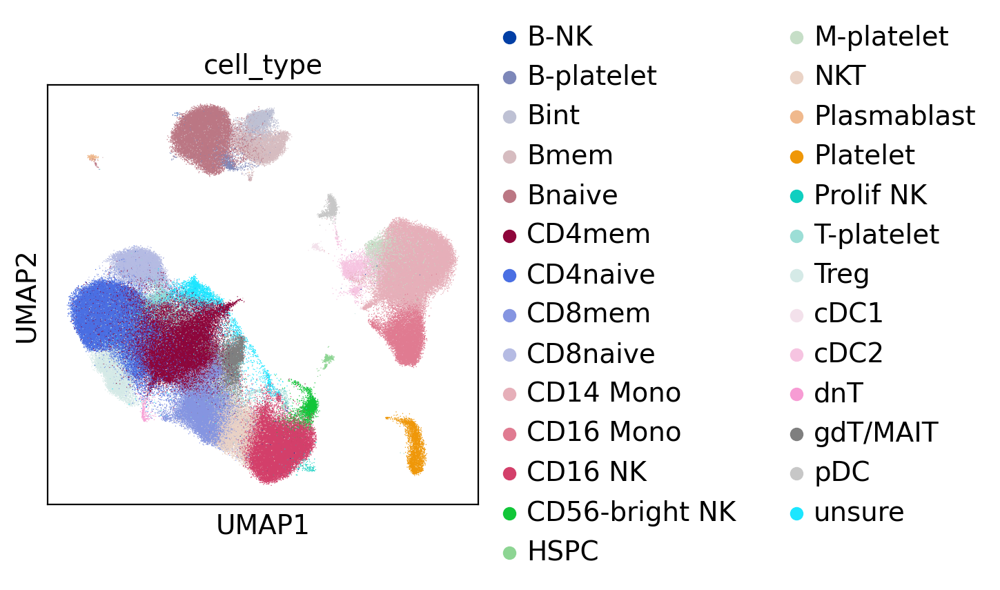

In [18]:
sc.pl.umap(adata_singlet, color = 'cell_type', size = 1, legend_fontsize = 'medium')

In [20]:
mplate_bc = adata_singlet.obs[adata_singlet.obs['cell_type']=='M-platelet']['barcode_2']

In [60]:
sc.tl.rank_genes_groups(adata, groupby='overcluster', method='t-test')

/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/media/MPEdge16/MM137/sc/py/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame i

In [65]:
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False, fontsize = 15)

In [5]:
type_ref = {
    '0': '',
    '1': '',
    '2': '',
    '3': '',
    '4': '',
    '5': '',
    '6': 'Myeloid',
    '7': '',
    '8': '',
    '9': 'Myeloid',
    '10': '',
    '11': '',
    '12': 'Myeloid',
    '13': '',
    '14': '',
    '15': '',
    '16': 'Myeloid',
    '17': 'Myeloid',
    '18': '',
    '19': '',
    '20': '',
    '21': 'Myeloid',
    '22': '',
    '23': 'Myeloid',
    '24': 'Myeloid',
    '25': '',
    '26': 'Myeloid',
    '27': 'Myeloid',
    '28': 'Myeloid',
    '29': '',
    '30': '',
    '31': 'Platelet',
    '32': '',
    '33': 'Myeloid',
    '34': 'Myeloid',
    '35': '',
    '36': '',
    '37': '',
    '38': '',
    '39': '',
    '40': 'Myeloid',
    '41': '',
    '42': '',
    '43': '',
    '44': '',
    '45': '',
    '46': ''
}

In [9]:
adata.obs['cell_group']

barcode_2
AAACCTGAGAAGATTC-1         13
AAACCTGAGACCTAGG-1          2
AAACCTGAGAGACGAA-1    Myeloid
AAACCTGAGAGAGCTC-1          0
AAACCTGAGAGCCCAA-1          0
                       ...   
TTTGTCATCTACCAGA-8          5
TTTGTCATCTATCCTA-8    Myeloid
TTTGTCATCTGATACG-8          4
TTTGTCATCTGGCGAC-8          2
TTTGTCATCTGTCTCG-8         25
Name: cell_group, Length: 419331, dtype: category
Categories (34, object): ['0', '1', '2', '3', ..., '44', '45', '46', 'Myeloid']

In [10]:
adata.obs['cell_group'] = adata.obs['overcluster'].map(type_ref)
myeloid_clusters = [str(x) for x in [6,9,12,16,17,21,23,24,26,27,28,33,34,40]]
adata.obs['cell_group'] = ['Myeloid' if x in myeloid_clusters else x for x in adata.obs['overcluster']]
adata.obs['cell_group'] = ['Platelet' if x=='31' else x for x in adata.obs['cell_group']]

In [7]:
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_int_dbl.h5ad')
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_int_dbl.h5ad')

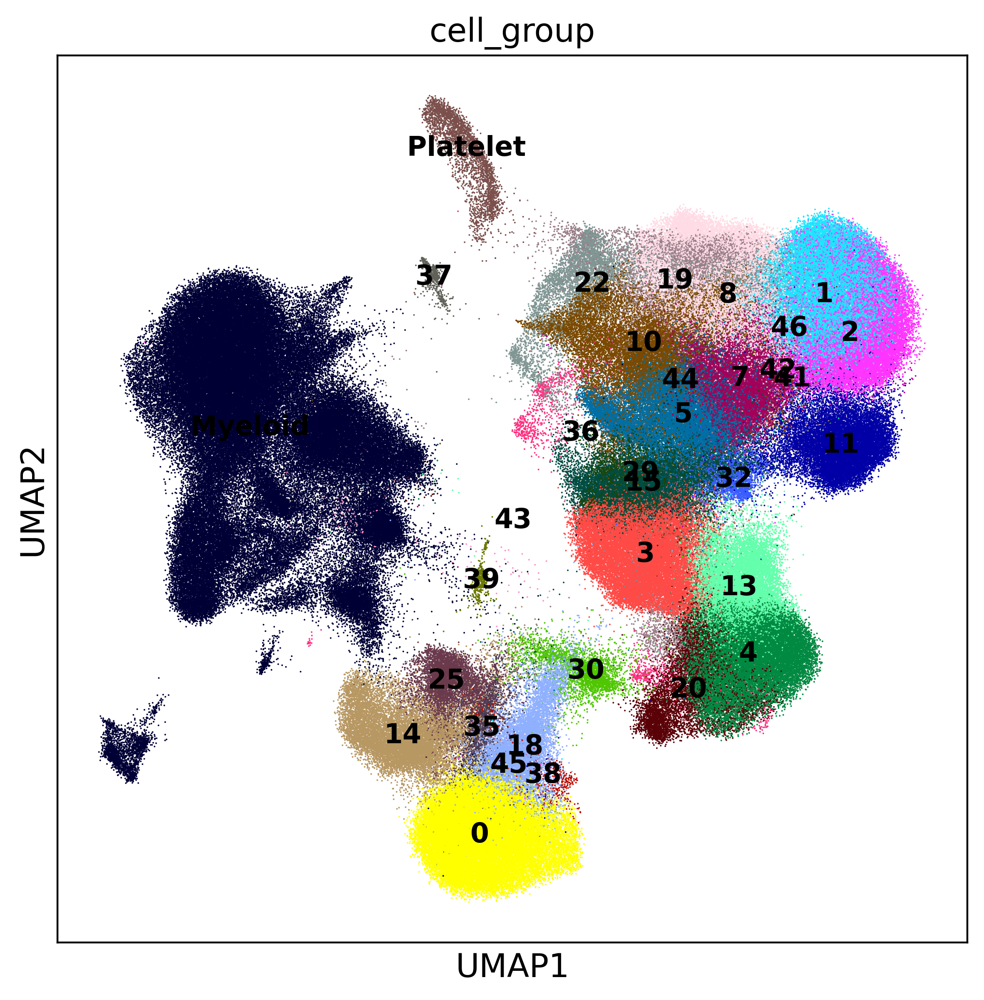

In [11]:
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color = ['cell_group'], legend_loc = 'on data', size = 2, layer = 'scvi_normalized', legend_fontsize = 'small')

In [79]:
# Convert 'overcluster' column to integer for processing
overcluster_int = adata.obs['overcluster'].astype(int)

# Get unique clusters sorted in ascending order
unique_clusters = sorted(overcluster_int.unique())

# Initialize lists to store the calculated frequencies
singlet_freqs = []
doublet_freqs = []
souporcell_doublet_freqs = []
doublet_sum_freqs = []

# Calculate frequencies for each cluster
for cluster in unique_clusters:
    cluster_data = adata.obs[overcluster_int == cluster]
    total_cells = len(cluster_data)
    
    singlet_freq = (cluster_data['solo_prediction'] == 'singlet').sum() / total_cells * 100
    doublet_freq = (cluster_data['solo_prediction'] == 'doublet').sum() / total_cells * 100
    souporcell_doublet_freq = (cluster_data['solo_prediction'] == 'souporcell_doublet').sum() / total_cells * 100
    doublet_sum_freq = doublet_freq + souporcell_doublet_freq
    
    singlet_freqs.append(singlet_freq)
    doublet_freqs.append(doublet_freq)
    souporcell_doublet_freqs.append(souporcell_doublet_freq)
    doublet_sum_freqs.append(doublet_sum_freq)

# Calculate overall frequencies
total_cells = len(adata.obs)
overall_singlet_freq = (adata.obs['solo_prediction'] == 'singlet').sum() / total_cells * 100
overall_doublet_freq = (adata.obs['solo_prediction'] == 'doublet').sum() / total_cells * 100
overall_souporcell_doublet_freq = (adata.obs['solo_prediction'] == 'souporcell_doublet').sum() / total_cells * 100

# Create the DataFrame for clusters
report_df = pd.DataFrame({
    'overcluster': [str(cluster) for cluster in unique_clusters],
    'singlet': singlet_freqs,
    'doublet': doublet_freqs,
    'souporcell_doublet': souporcell_doublet_freqs,
    'doublet_sum': doublet_sum_freqs
})

# Add overall frequencies to the DataFrame
overall_df = pd.DataFrame({
    'overcluster': ['overall'],
    'singlet': [overall_singlet_freq],
    'doublet': [overall_doublet_freq],
    'souporcell_doublet': [overall_souporcell_doublet_freq],
    'doublet_sum': [overall_doublet_freq + overall_souporcell_doublet_freq]
})

# Use pd.concat to append the overall frequencies to the report DataFrame
final_report_df = pd.concat([report_df, overall_df], ignore_index=True)

print(final_report_df)

   overcluster    singlet    doublet  souporcell_doublet  doublet_sum
0            0  84.041980   4.502362           11.455658    15.958020
1            1  84.620705   8.262959            7.116337    15.379295
2            2  86.139562   8.181364            5.679074    13.860438
3            3  75.713820  11.388514           12.897666    24.286180
4            4  88.443716   6.482565            5.073719    11.556284
5            5  79.015569  12.393203            8.591228    20.984431
6            6   1.665733  38.571647           59.762620    98.334267
7            7  79.649243  13.136317            7.214440    20.350757
8            8  78.187554  13.031259            8.781187    21.812446
9            9  83.734867  11.894673            4.370460    16.265133
10          10  85.542696   7.194245            7.263059    14.457304
11          11  78.782357  11.409902            9.807741    21.217643
12          12  85.163956  11.250333            3.585710    14.836044
13          13  41.8

In [83]:
# check that overall 'doublet' rate is correct
np.mean(adata.obs['solo_prediction']=='doublet') * 100

14.041175109877399

In [84]:
# check that overall 'souporcell_doublet' rate is correct
np.mean(adata.obs['solo_prediction']=='souporcell_doublet') * 100

16.39492429608114

In [90]:
overall_rate = final_report_df.iloc[np.where(final_report_df['overcluster']=='overall')]
cluster_rate = final_report_df.iloc[np.where(final_report_df['overcluster']!='overall')]

In [93]:
# Extract overall rates for singlet, doublet, and souporcell_doublet
overall_singlet = overall_rate.loc[overall_rate['overcluster'] == 'overall', 'singlet'].values[0]
overall_doublet = overall_rate.loc[overall_rate['overcluster'] == 'overall', 'doublet'].values[0]
overall_souporcell_doublet = overall_rate.loc[overall_rate['overcluster'] == 'overall', 'souporcell_doublet'].values[0]

# Subtract overall rates from each corresponding column in cluster_rate
new_cluster_rate = cluster_rate.copy()
new_cluster_rate['singlet'] = cluster_rate['singlet'] - overall_singlet
new_cluster_rate['doublet'] = cluster_rate['doublet'] - overall_doublet
new_cluster_rate['souporcell_doublet'] = cluster_rate['souporcell_doublet'] - overall_souporcell_doublet

print(new_cluster_rate)

   overcluster    singlet    doublet  souporcell_doublet  doublet_sum
0            0  14.478079  -9.538813           -4.939266    15.958020
1            1  15.056804  -5.778216           -9.278588    15.379295
2            2  16.575661  -5.859811          -10.715850    13.860438
3            3   6.149919  -2.652661           -3.497258    24.286180
4            4  18.879816  -7.558610          -11.321206    11.556284
5            5   9.451668  -1.647972           -7.803696    20.984431
6            6 -67.898168  24.530472           43.367696    98.334267
7            7  10.085342  -0.904858           -9.180484    20.350757
8            8   8.623653  -1.009916           -7.613737    21.812446
9            9  14.170966  -2.146502          -12.024464    16.265133
10          10  15.978796  -6.846931           -9.131865    14.457304
11          11   9.218457  -2.631273           -6.587184    21.217643
12          12  15.600056  -2.790842          -12.809214    14.836044
13          13 -27.7

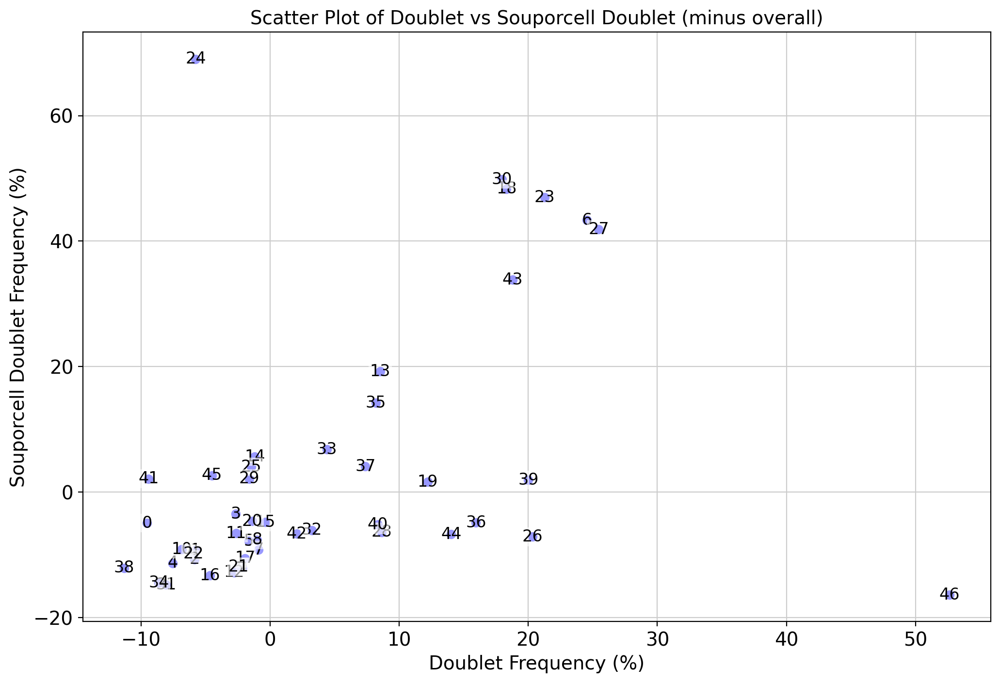

In [97]:
import matplotlib.pyplot as plt

# Create scatter plot
plt.figure(figsize=(12, 8))
plt.scatter(new_cluster_rate['doublet'], new_cluster_rate['souporcell_doublet'], color='blue')

# Add labels to each data point
for i, row in new_cluster_rate.iterrows():
    plt.text(row['doublet'], row['souporcell_doublet'], row['overcluster'], fontsize=12, ha='center', va='center',
             bbox=dict(facecolor='white', alpha=0.6, edgecolor='none', pad=1))

# Add titles and labels
plt.title('Scatter Plot of Doublet vs Souporcell Doublet (minus overall)')
plt.xlabel('Doublet Frequency (%)')
plt.ylabel('Souporcell Doublet Frequency (%)')

# Show plot
plt.grid(True)
plt.show()

In [102]:
adata_myl = adata[adata.obs['cell_group']=='Myeloid']
adata_myl.shape
adata_myl.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_dbl.h5ad')